In [ ]:
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs

In [ ]:
# Define the Generator
class Generator(nn.Module):
    def __init__(self, latent_dim, output_dim):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(latent_dim, 16),
            nn.ReLU(),
            nn.Linear(16, 32),
            nn.ReLU(),
            nn.Linear(32, output_dim)
        )

    def forward(self, z):
        return self.model(z)

# Define the Discriminator
class Discriminator(nn.Module):
    def __init__(self, input_dim):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, 32),
            nn.ReLU(),
            nn.Linear(32, 16),
            nn.ReLU(),
            nn.Linear(16, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

In [ ]:
N = 1000
centers = [[0, 0]]
cluster_std = 1.0
X, _ = make_blobs(n_samples=N, n_features=2, centers=centers, cluster_std=cluster_std)
X = torch.tensor(X, dtype=torch.float32)

In [ ]:
# Hyperparameters
latent_dim = 2
data_dim = 2
epochs = 350
batch_size = 128
lr = 0.001
use_gpu = False

# Initialize models
generator = Generator(latent_dim, data_dim)
discriminator = Discriminator(data_dim)

evolution_intervals = [0, 50, 100, 150, 250, 350]

# Loss and optimizers
loss_fn = nn.BCELoss()


def train_gan_gen(generator, discriminator, sample_gan=False, sample_from=None):

  device = torch.device("cuda:0" if use_gpu and torch.cuda.is_available() else "cpu")
  generator = Generator(latent_dim, data_dim).to(device)
  discriminator = Discriminator(data_dim).to(device)

  #num_params = sum(p.numel() for p in gan.parameters() if p.requires_grad)
  #print('Number of parameters: %d' % num_params)

  optimizer_g = torch.optim.Adam(generator.parameters(), lr=lr)
  optimizer_d = torch.optim.Adam(discriminator.parameters(), lr=lr)

  generator.train()
  discriminator.train()

  train_loss_avg = []

  print('Training ...')
  for epoch in range(epochs):
      train_loss_avg.append(0)
      num_batches = 0

      for _ in range(N // batch_size):

        # Train Discriminator
        real_idx = torch.randint(0, X.size(0), (batch_size,))
        real_data = X[real_idx]
        noise = torch.randn(batch_size, latent_dim)
        fake_data = generator(noise)

        real_labels = torch.ones(batch_size, 1)
        fake_labels = torch.zeros(batch_size, 1)

        d_real_loss = loss_fn(discriminator(real_data), real_labels)
        d_fake_loss = loss_fn(discriminator(fake_data.detach()), fake_labels)
        d_loss = d_real_loss + d_fake_loss

        optimizer_d.zero_grad()
        d_loss.backward()
        optimizer_d.step()

        # Train Generator
        noise = torch.randn(batch_size, latent_dim)
        fake_data = generator(noise)


        if sample_gan:
           with torch.no_grad():
              noise = torch.randn(batch_size, latent_dim)
              fake_data = generator(noise)

        g_loss = loss_fn(discriminator(fake_data), real_labels)

        optimizer_g.zero_grad()
        g_loss.backward()
        optimizer_g.step()

        train_loss_avg[-1] += g_loss.item()
        num_batches += 1

        if (epoch + 1) in evolution_intervals:
          with torch.no_grad():
            noise = torch.randn(batch_size, latent_dim)
            gen_data = generator(noise)
            generated_samples = gen_data.numpy()

          fig, ax = plt.subplots(figsize=(5, 5))
          plt.title(f"Evolution {(epoch + 1)}")
          plt.scatter(X[:, 0], X[:, 1], c='purple', alpha=0.5, label="Original Data")
          plt.scatter(generated_samples[:, 0], generated_samples[:, 1], c='yellow', alpha=0.5, label="Generated Data")
          plt.legend()

      train_loss_avg[-1] /= num_batches
      print(f"Epoch: {epoch}, D Loss: {d_loss.item():.4f}, G Loss: {g_loss.item():.4f}")

Training ...
Epoch: 0, D Loss: 1.3630, G Loss: 0.6362
Epoch: 1, D Loss: 1.3552, G Loss: 0.6518
Epoch: 2, D Loss: 1.3330, G Loss: 0.6790
Epoch: 3, D Loss: 1.3130, G Loss: 0.7130
Epoch: 4, D Loss: 1.2857, G Loss: 0.7469
Epoch: 5, D Loss: 1.2463, G Loss: 0.7804
Epoch: 6, D Loss: 1.2182, G Loss: 0.7970
Epoch: 7, D Loss: 1.2369, G Loss: 0.7950
Epoch: 8, D Loss: 1.2460, G Loss: 0.7658
Epoch: 9, D Loss: 1.2476, G Loss: 0.7248
Epoch: 10, D Loss: 1.2676, G Loss: 0.6862
Epoch: 11, D Loss: 1.2937, G Loss: 0.6538
Epoch: 12, D Loss: 1.2628, G Loss: 0.6466
Epoch: 13, D Loss: 1.2498, G Loss: 0.6439
Epoch: 14, D Loss: 1.2745, G Loss: 0.6453
Epoch: 15, D Loss: 1.1841, G Loss: 0.6597
Epoch: 16, D Loss: 1.1705, G Loss: 0.7119
Epoch: 17, D Loss: 1.1184, G Loss: 0.7570
Epoch: 18, D Loss: 0.9912, G Loss: 0.8320
Epoch: 19, D Loss: 0.9880, G Loss: 0.9088
Epoch: 20, D Loss: 0.9134, G Loss: 0.9866
Epoch: 21, D Loss: 0.8453, G Loss: 1.0554
Epoch: 22, D Loss: 0.7566, G Loss: 1.1475
Epoch: 23, D Loss: 0.7387, G Lo

<ipython-input-4-a1fdb7ffa58c>:85: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(5, 5))


Epoch: 149, D Loss: 1.3076, G Loss: 0.6680
Epoch: 150, D Loss: 1.2630, G Loss: 0.7112
Epoch: 151, D Loss: 1.2280, G Loss: 0.7365
Epoch: 152, D Loss: 1.2111, G Loss: 0.7505
Epoch: 153, D Loss: 1.1752, G Loss: 0.7820
Epoch: 154, D Loss: 1.1380, G Loss: 0.7986
Epoch: 155, D Loss: 1.0949, G Loss: 0.8246
Epoch: 156, D Loss: 1.1177, G Loss: 0.8427
Epoch: 157, D Loss: 1.0283, G Loss: 0.9140
Epoch: 158, D Loss: 1.0697, G Loss: 0.9121
Epoch: 159, D Loss: 1.0458, G Loss: 0.9247
Epoch: 160, D Loss: 1.0274, G Loss: 0.9008
Epoch: 161, D Loss: 1.0104, G Loss: 0.8744
Epoch: 162, D Loss: 1.1689, G Loss: 0.8094
Epoch: 163, D Loss: 1.1626, G Loss: 0.7551
Epoch: 164, D Loss: 1.2294, G Loss: 0.7116
Epoch: 165, D Loss: 1.2943, G Loss: 0.6524
Epoch: 166, D Loss: 1.3482, G Loss: 0.6192
Epoch: 167, D Loss: 1.4300, G Loss: 0.6400
Epoch: 168, D Loss: 1.4637, G Loss: 0.6263
Epoch: 169, D Loss: 1.5260, G Loss: 0.6672
Epoch: 170, D Loss: 1.4962, G Loss: 0.6607
Epoch: 171, D Loss: 1.5674, G Loss: 0.6860
Epoch: 172,

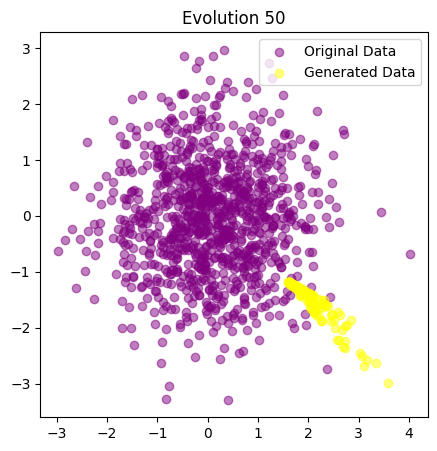

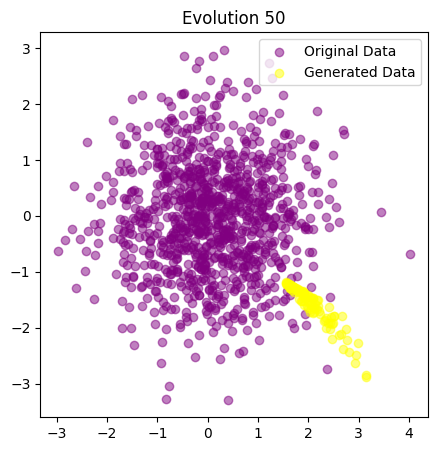

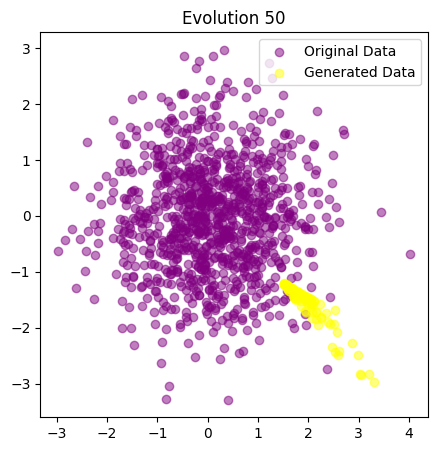

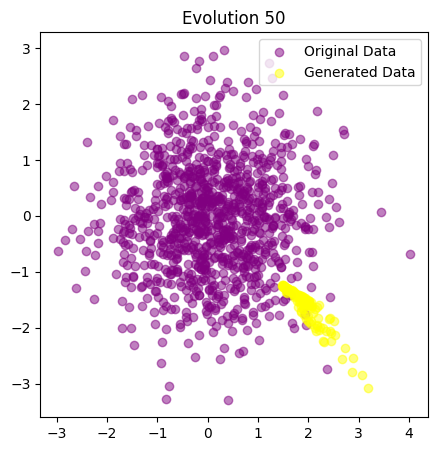

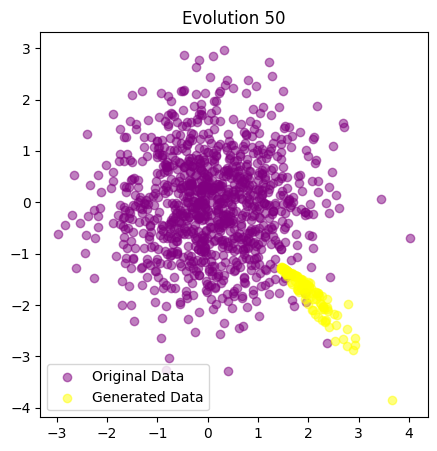

...

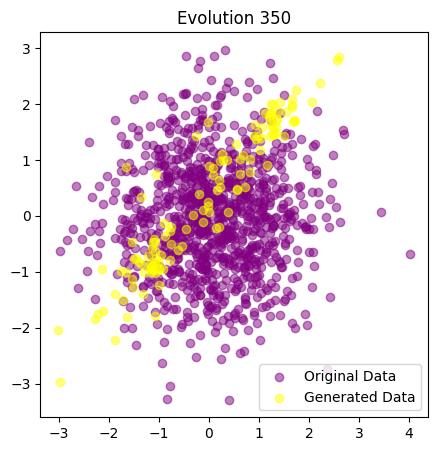

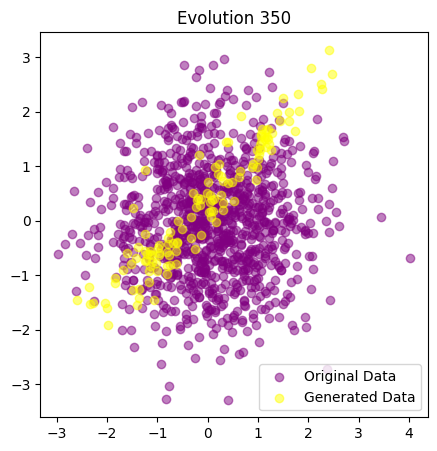

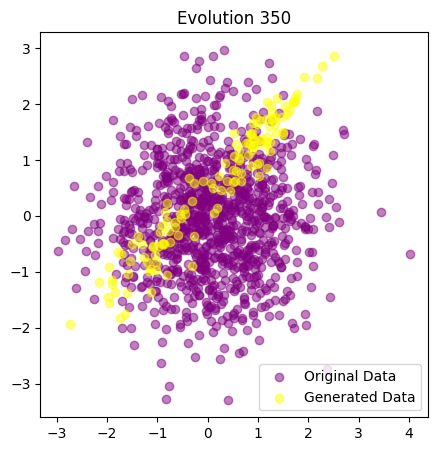

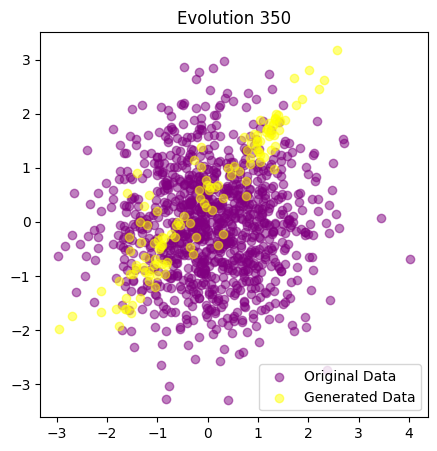

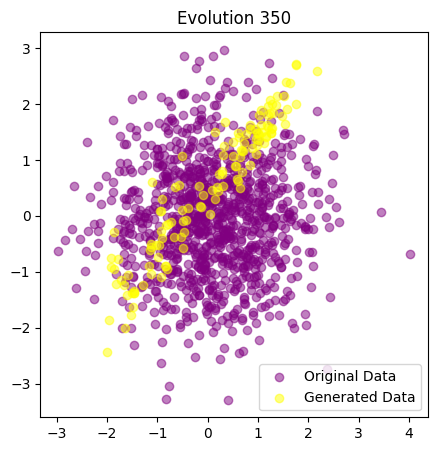

In [ ]:
train_gan_gen(generator, discriminator, False, None)

0
Training ...
Epoch: 0, D Loss: 1.3193, G Loss: 0.6675
Epoch: 1, D Loss: 1.2919, G Loss: 0.6917
Epoch: 2, D Loss: 1.2643, G Loss: 0.7154
Epoch: 3, D Loss: 1.2240, G Loss: 0.7378
Epoch: 4, D Loss: 1.1859, G Loss: 0.7614
Epoch: 5, D Loss: 1.1595, G Loss: 0.7870
Epoch: 6, D Loss: 1.1242, G Loss: 0.8154
Epoch: 7, D Loss: 1.0501, G Loss: 0.8494
Epoch: 8, D Loss: 0.9872, G Loss: 0.8836
Epoch: 9, D Loss: 0.9630, G Loss: 0.9226
Epoch: 10, D Loss: 0.9328, G Loss: 0.9660
Epoch: 11, D Loss: 0.8549, G Loss: 1.0056
Epoch: 12, D Loss: 0.7718, G Loss: 1.0575
Epoch: 13, D Loss: 0.7637, G Loss: 1.1076
Epoch: 14, D Loss: 0.7353, G Loss: 1.1517
Epoch: 15, D Loss: 0.6982, G Loss: 1.1969
Epoch: 16, D Loss: 0.6093, G Loss: 1.2627
Epoch: 17, D Loss: 0.6391, G Loss: 1.3071
Epoch: 18, D Loss: 0.5336, G Loss: 1.3618
Epoch: 19, D Loss: 0.5865, G Loss: 1.3894
Epoch: 20, D Loss: 0.5067, G Loss: 1.4395
Epoch: 21, D Loss: 0.4896, G Loss: 1.5361
Epoch: 22, D Loss: 0.4678, G Loss: 1.5558
Epoch: 23, D Loss: 0.4295, G 

<ipython-input-4-a1fdb7ffa58c>:85: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(5, 5))


Epoch: 149, D Loss: 0.1519, G Loss: 3.2003
Epoch: 150, D Loss: 0.1015, G Loss: 3.3597
Epoch: 151, D Loss: 0.1081, G Loss: 3.5860
Epoch: 152, D Loss: 0.1519, G Loss: 3.4480
Epoch: 153, D Loss: 0.1137, G Loss: 3.2774
Epoch: 154, D Loss: 0.1546, G Loss: 3.4991
Epoch: 155, D Loss: 0.1657, G Loss: 3.5530
Epoch: 156, D Loss: 0.1436, G Loss: 3.8312
Epoch: 157, D Loss: 0.1710, G Loss: 3.7513
Epoch: 158, D Loss: 0.1262, G Loss: 3.5424
Epoch: 159, D Loss: 0.1192, G Loss: 3.6426
Epoch: 160, D Loss: 0.1936, G Loss: 3.8194
Epoch: 161, D Loss: 0.2621, G Loss: 3.5809
Epoch: 162, D Loss: 0.1259, G Loss: 3.6947
Epoch: 163, D Loss: 0.0927, G Loss: 3.6712
Epoch: 164, D Loss: 0.1377, G Loss: 3.7659
Epoch: 165, D Loss: 0.1908, G Loss: 3.6145
Epoch: 166, D Loss: 0.1753, G Loss: 3.5375
Epoch: 167, D Loss: 0.2116, G Loss: 3.6783
Epoch: 168, D Loss: 0.0889, G Loss: 3.6742
Epoch: 169, D Loss: 0.2057, G Loss: 3.6356
Epoch: 170, D Loss: 0.1919, G Loss: 3.5943
Epoch: 171, D Loss: 0.1511, G Loss: 3.4379
Epoch: 172,

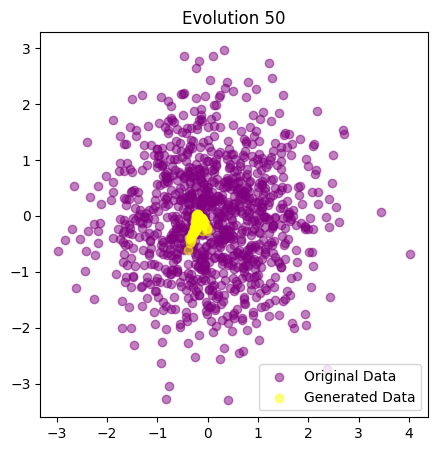

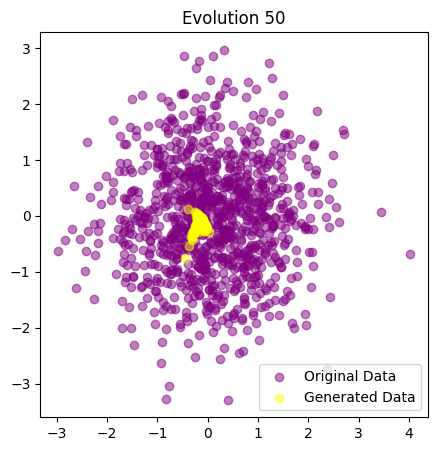

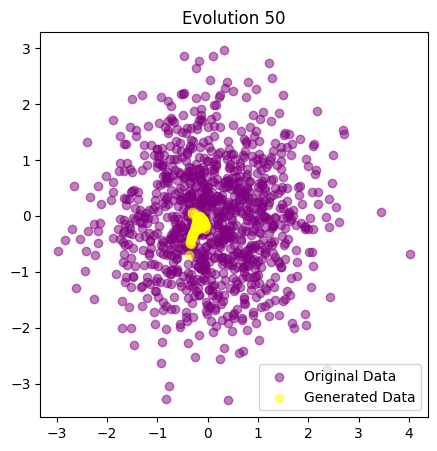

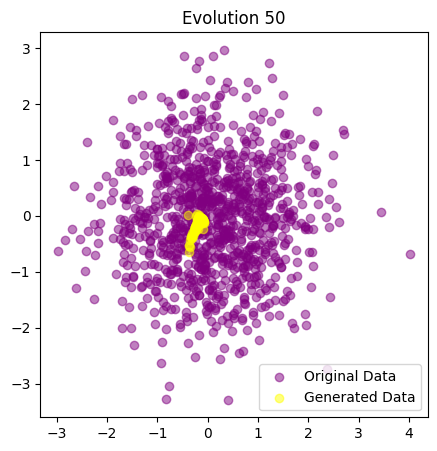

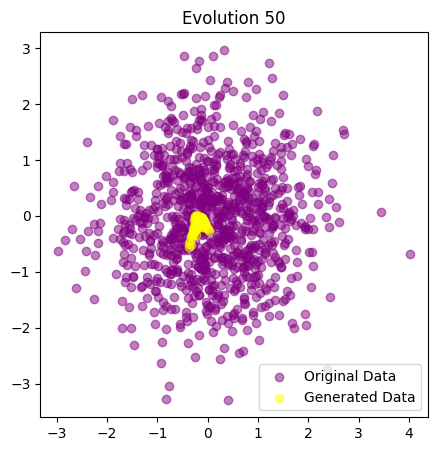

...

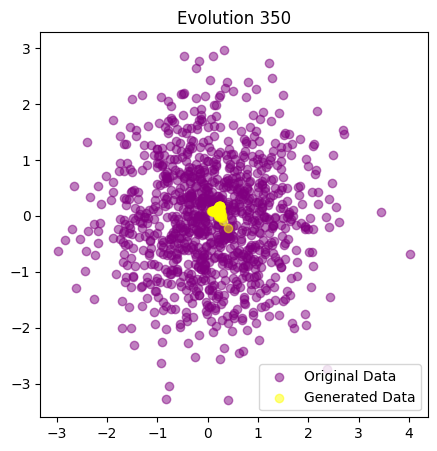

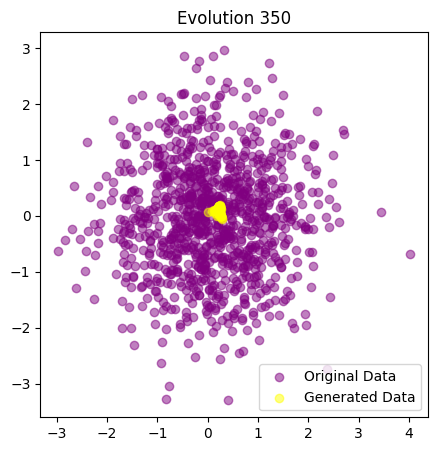

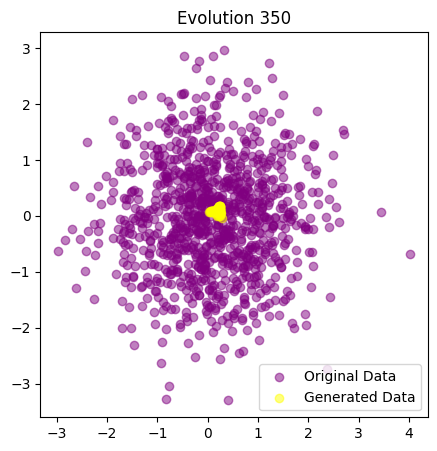

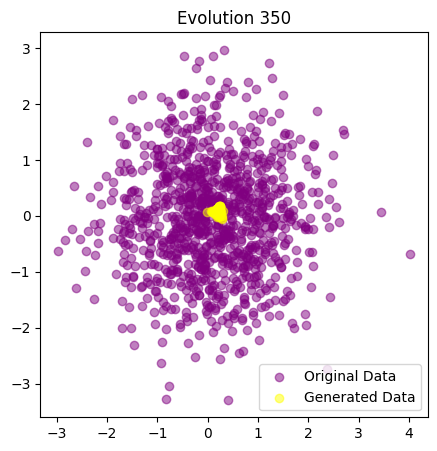

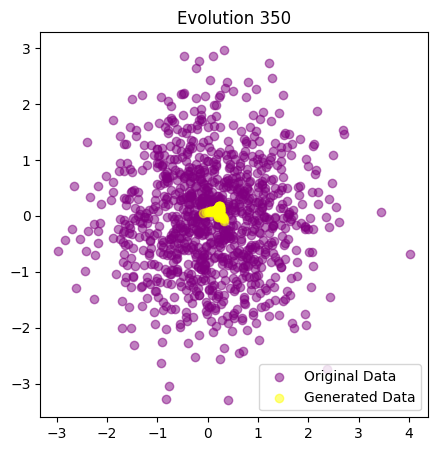

In [ ]:
device = torch.device("cuda:0" if use_gpu and torch.cuda.is_available() else "cpu")
last_gen = generator
evolution_intervals = [0, 50, 100, 150, 250, 350]

for gen_number in range(5):
  print(gen_number)

  generator = Generator(latent_dim, data_dim)
  discriminator = Discriminator(data_dim)

  generator = generator.to(device)
  discriminator = discriminator.to(device)

  train_gan_gen(generator, discriminator, True, last_gen)

  last_gen = generator

  if (gen_number + 1) in evolution_intervals:
    with torch.no_grad():
      noise = torch.randn(batch_size, latent_dim)
      gen_data = generator(noise)
      generated_samples = gen_data.numpy()

    fig, ax = plt.subplots(figsize=(5, 5))
    plt.title(f"Evolution {gen_number}")
    plt.scatter(X[:, 0], X[:, 1], c='purple', alpha=0.5, label="Original Data")
    plt.scatter(generated_samples[:, 0], generated_samples[:, 1], c='yellow', alpha=0.5, label="Generated Data")
    plt.legend()